In [1]:
import pandas as pd
import os
import matplotlib.pyplot as plt
import numpy as np

import tensorflow as tf
from tensorflow import keras
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import train_test_split

plt.style.use("bmh")
plt.rcParams["figure.figsize"] = (15,10)

## Load and pre-process data

### 1) Global parameters

In [2]:
SOURCE_PATH = os.path.dirname(os.getcwd())

N_JOBS = 1  # number of jobs to run in parallel
N_SPLITS = 10  # number of splits (k) to be made within the k fold cv
N_ITER = 50  # number of parameter settings that are sampled
SEED = 2294
VERBOSE = True
INPUTS_PATH = os.path.join(SOURCE_PATH, "data", "inputs")
OUTPUTS_PATH = os.path.join(SOURCE_PATH, "data", "outputs")
DATASET_NAMES = ["betadgp_covdgp_data", "betadgp_beta2x2_data", "betadgp_data"]
TARGET_NAME = "betas_dgp"
MODEL_TAG = "ffnn"
STANDARDIZE = True
CLASS = True
TRAIN_SIZE = 0.7 # size of training data (in %)

VALIDATION_SIZE = 0.2

### 2) Local parameters

In [3]:
DIR_NAMES = os.listdir(os.path.join(INPUTS_PATH))

inputs_path = INPUTS_PATH
target_name = TARGET_NAME
standardize = STANDARDIZE
train_size = TRAIN_SIZE

dir_name = DIR_NAMES[0]
d_name = DATASET_NAMES[0] 

In [4]:
train_data = pd.read_csv(os.path.join(inputs_path, dir_name, d_name + ".csv"))
train_data.set_index(["Var1", "Var2"], inplace=True)
y_train = train_data[[target_name]].to_numpy()
X_train = train_data.drop([target_name], axis=1).to_numpy()

test_data = pd.read_csv(os.path.join(inputs_path, dir_name, d_name + "_test.csv"))
test_data.set_index(["Var1", "Var2"], inplace=True)
y_test = test_data[[target_name]].to_numpy()
X_test = test_data.drop([target_name], axis=1).to_numpy()

if standardize:
    X_train, X_validation, y_train, y_validation = train_test_split(X_train, y_train, train_size=train_size)

    scaler = StandardScaler()
    X_train_zscore = scaler.fit_transform(X_train)
    X_validation_zscore = scaler.transform(X_validation)
    X_test_zscore = scaler.transform(X_test)
    
if CLASS:
    y_train = np.where(y_train > 0, 0.99, 0)
    y_test = np.where(y_test > 0, 0.99, 0)

In [5]:
X_train.shape

(15644, 1)

In [6]:
X_validation.shape

(6706, 1)

In [7]:
train_data.tail()

betas_dgp   cov_dgp
Var1 Var2                     
150  145         0.0 -0.019311
     146         0.0 -0.019746
     147         0.0  0.045535
     148         0.0  0.053179
     149         0.0 -0.193679

array([[<AxesSubplot:title={'center':'betas_dgp'}>]], dtype=object)

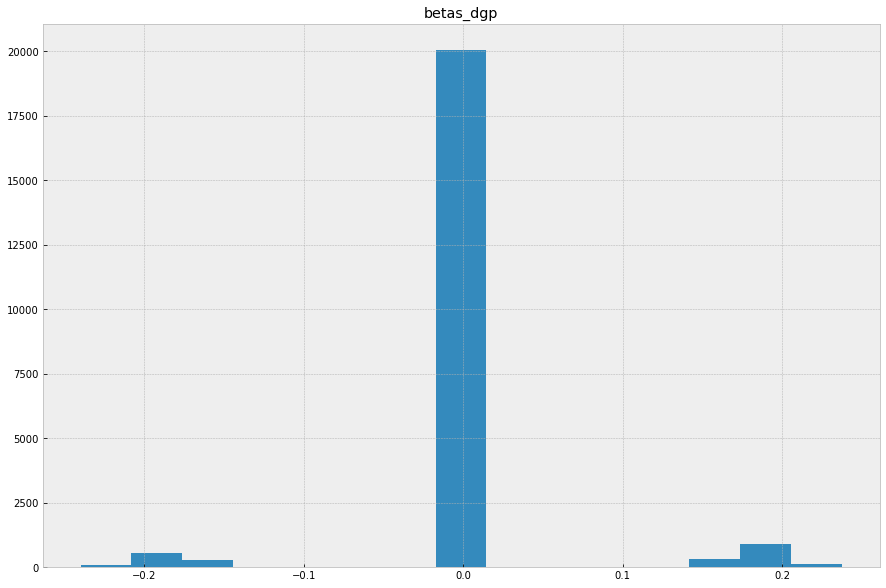

In [8]:
train_data[["betas_dgp"]].hist(bins=15)

array([[<AxesSubplot:title={'center':'cov_dgp'}>]], dtype=object)

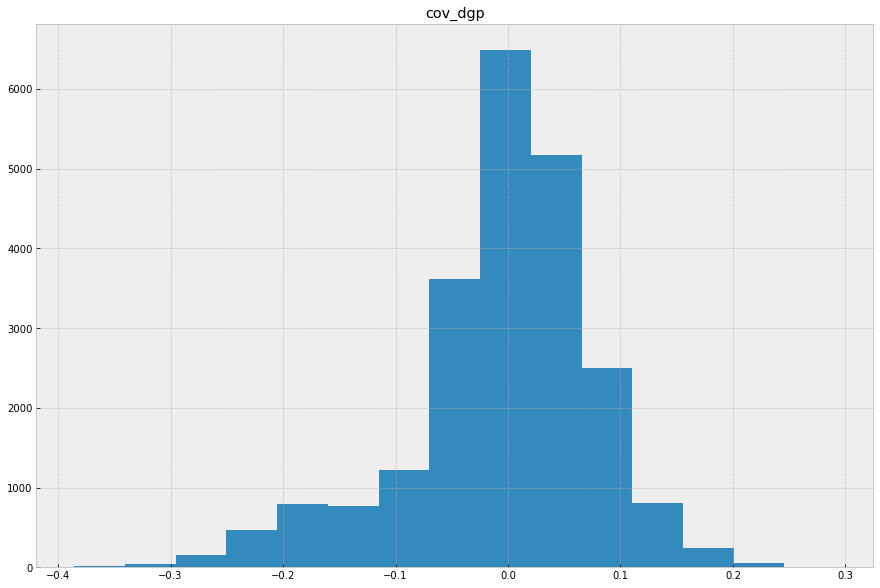

In [9]:
train_data[["cov_dgp"]].hist(bins=15)

## Model

### 1) Definition and Estimation

In [10]:
from scipy.stats import reciprocal
import numpy as np

def FFNN(n_hidden,
         n_neurons,
         input_shape,
         learning_rate,
         activation,
         loss_name):
    model = keras.models.Sequential()
    model.add(keras.layers.InputLayer(input_shape=input_shape))

    for layer in range(n_hidden):
        model.add(keras.layers.Dense(n_neurons, activation=activation))
    model.add(keras.layers.Dense(1, activation="softmax"))

    if loss_name == "mse":
        loss = losss_name
    elif loss_name == "wmse":
        loss = weighted_mean_squared_error
    elif loss_name == "cross_entropy":
        loss = keras.losses.SparseCategoricalCrossentropy()
    
    optimizer = keras.optimizers.SGD(lr=learning_rate)
    model.compile(loss=loss, optimizer=optimizer)

    return model

class FFNNWrapper():
    def __init__(self, model_params=None):
        self.model_name = "ffnn"
        self.search_type = 'random'
        self.param_grid = {"n_hidden": [1, 2],
                           "n_neurons": np.arange(1, 10+1),
                           "learning_rate": reciprocal(3e-4, 3e-2),
                           "activation": ["relu"],
                           "loss_name": ["cross_entropy"]}
        self.ModelClass = keras.wrappers.scikit_learn.KerasRegressor(FFNN)

        if model_params is not None:
            self.param_grid.update(model_params)

In [11]:
from sklearn.metrics import mean_squared_error, make_scorer
from sklearn.model_selection import RandomizedSearchCV, KFold

cv_splits = KFold(n_splits=N_SPLITS)
mse_scorer = make_scorer(mean_squared_error)

wrapper = FFNNWrapper(model_params={"input_shape": [X_train_zscore.shape[1]]})

model_search = RandomizedSearchCV(estimator=wrapper.ModelClass,
                                  param_distributions=wrapper.param_grid,
                                  n_iter=N_ITER,
                                  cv=cv_splits,
                                  verbose=0,
                                  n_jobs=N_JOBS,
                                  random_state=SEED) 

In [12]:
opt_model_search = model_search.fit(X_train_zscore,
                                    y_train,
                                    epochs=50,
                                    callbacks=[keras.callbacks.EarlyStopping(patience=10)],
                                    validation_data=(X_validation_zscore, y_validation),
                                    verbose=False)

1565/1 [================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================

### 2) Results

#### Training parameters

In [13]:
model_search

RandomizedSearchCV(cv=KFold(n_splits=10, random_state=None, shuffle=False),
                   error_score='raise-deprecating',
                   estimator=<tensorflow.python.keras.wrappers.scikit_learn.KerasRegressor object at 0x7fd8f55cf9b0>,
                   iid='warn', n_iter=50, n_jobs=1,
                   param_distributions={'activation': ['relu'],
                                        'input_shape': [1],
                                        'learning_rate': <scipy.stats._distn_infrastructure.rv_frozen object at 0x7fd8f55e3c50>,
                                        'loss_name': ['cross_entropy'],
                                        'n_hidden': [1, 2],
                                        'n_neurons': array([ 1,  2,  3,  4,  5,  6,  7,  8,  9, 10])},
                   pre_dispatch='2*n_jobs', random_state=2294, refit=True,
                   return_train_score=False, scoring=None, verbose=0)

#### Hyperparameter grid

In [14]:
opt_model_search.param_distributions

{'n_hidden': [1, 2],
 'n_neurons': array([ 1,  2,  3,  4,  5,  6,  7,  8,  9, 10]),
 'learning_rate': <scipy.stats._distn_infrastructure.rv_frozen at 0x7fd8f55e3c50>,
 'activation': ['relu'],
 'loss_name': ['cross_entropy'],
 'input_shape': [1]}

#### Optimal parameters

In [16]:
opt_model_search.best_params_

{'activation': 'relu',
 'input_shape': 1,
 'learning_rate': 0.0005736931967234547,
 'loss_name': 'cross_entropy',
 'n_hidden': 1,
 'n_neurons': 9}

#### CV results

In [17]:
opt_model_search.cv_results_.keys()

dict_keys(['mean_fit_time', 'std_fit_time', 'mean_score_time', 'std_score_time', 'param_activation', 'param_input_shape', 'param_learning_rate', 'param_loss_name', 'param_n_hidden', 'param_n_neurons', 'params', 'split0_test_score', 'split1_test_score', 'split2_test_score', 'split3_test_score', 'split4_test_score', 'split5_test_score', 'split6_test_score', 'split7_test_score', 'split8_test_score', 'split9_test_score', 'mean_test_score', 'std_test_score', 'rank_test_score'])

In [23]:
opt_model_search.history

AttributeError: 'RandomizedSearchCV' object has no attribute 'history'

### 3) OOS prediction

In [22]:
test_pred = model_search.best_estimator_.predict(X_test_zscore)
output = pd.DataFrame({"Var1": test_data.reset_index()["Var1"],
                       "Var2": test_data.reset_index()["Var2"],
                       "y": y_test.ravel(),
                       "pred": test_pred.ravel()})

mse = mean_squared_error(y_true=output["y"],
                         y_pred=output["pred"])

In [23]:
output.tail()

,Var1,Var2,y,pred
22495,150,146,0.000000,-0.086576
22496,150,147,-0.185358,-0.187610
22497,150,148,0.000000,0.029961
22498,150,149,0.000000,-0.166191
22499,150,150,0.000000,-1.610771


In [24]:
mse

0.02765338317273578

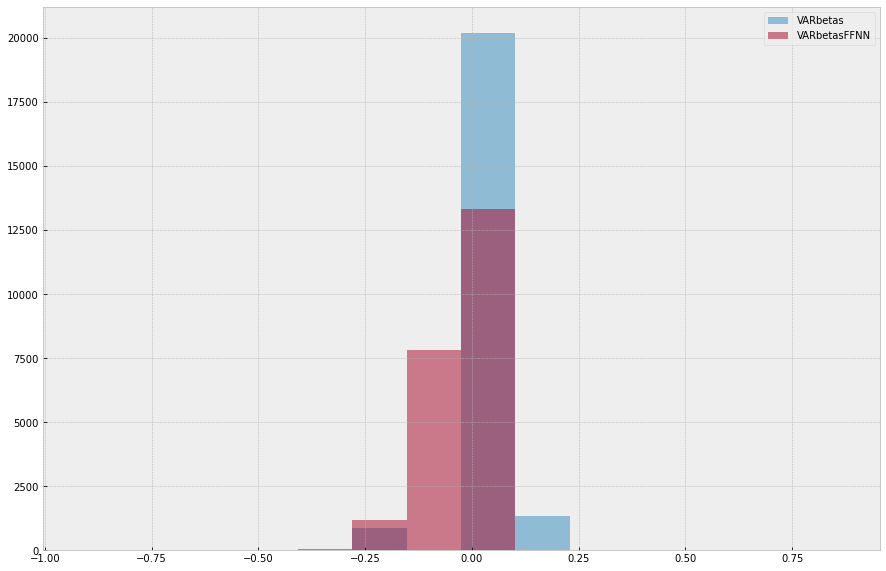

In [25]:
bins = np.linspace(np.min(np.array(output['y'].min(), output['pred'].min())),
                   np.min(np.array(output['y'].max(), output['pred'].max())),
                   15)
plt.hist(output['y'], bins, alpha=0.5, label='VARbetas')
plt.hist(output['pred'], bins, alpha=0.5, label='VARbetasFFNN')
plt.legend(loc='upper right')
plt.show()